In [47]:
# Modules Analyse de données
import plotly.express as px                # pip install plotly
import pandas as pd                        # pip install pandas
import geopandas as gpd                    # pip install geopandas
import gc
import datetime

# Module de scraping
import requests                            # pip install requests
import gzip                                # pip install gzip
import json
from io import BytesIO


# Fonction utiles pour la suite
def dllliste_departement(): # Fonction pour telecharger la liste des departements
    try:
        liste_departement = pd.read_csv("https://raw.githubusercontent.com/enzofranzy/DVF-dash-plotly/main/departements-france.csv").drop(columns=["Unnamed: 0"]).rename(columns={"code_departement":"code"})
    except:
        liste_departement = "Il est impossible de télécharger la liste des departements"
    return liste_departement

def dlldvfdepartement(departement_name): # Fonction pour telecharger le dvf du département selectionné & les geojson des communes
    liste_departement = dllliste_departement()
    codedepartement = liste_departement.loc[liste_departement["nom_departement"]==departement_name,"code"].value_counts().keys()[0]
    departementgeojson = liste_departement.loc[liste_departement["nom_departement"]==departement_name,"departement"].value_counts().keys()[0]
    try:
        urldepartementgeojson = f"https://raw.githubusercontent.com/gregoiredavid/france-geojson/master/departements/{departementgeojson}/communes-{departementgeojson}.geojson"
        response2 = json.loads(requests.get(urldepartementgeojson).text)
        dvf = pd.read_csv(f"https://github.com/enzofranzy/DVF-dash-plotly/blob/main/dvf_id_total/{codedepartement}ret_id_total.csv.xz?raw=true", compression='xz') # Telechargement du dvf directement sur GITHUB en .csv.xz
        dvf['code_departement'] = dvf['code_departement'].astype('str')
        dvf['code_commune'] = dvf['code_commune'].astype('str')
        dvf['code_departement'] = dvf['code_departement'].str.zfill(2) # nous voulons que chaque code de département ait deux caractères, donc nous allons utiliser zfill(2) pour ajouter un "0" devant les valeurs qui n'en ont qu'un
        dvf['code_commune'] = dvf['code_commune'].str.zfill(5)
        dvf["code_commune_fig_commune"] = dvf['code_commune'] # Création de la colonne code_commune_fig_commune
        dvf["section"] = dvf["id_parcelle"].str.slice(0, 10) # Corrige la colonne section car erreur fichier source => Correction faite sur Download_DVFbyRegion => lignes inutiles
        dvf["Nombre_Dépendance"] = dvf["Nombre_Dépendance"].fillna(0) #Corrige la colonne Nombre_dépendance pour éviter les erreurs ensuite
        dvf["Nombre_Maison"] = dvf["Nombre_Maison"].fillna(0) #Corrige la colonne Nombre_dépendance pour éviter les erreurs ensuite
        dvf["Nombre_Appartement"] = dvf["Nombre_Appartement"].fillna(0) #Corrige la colonne Nombre_dépendance pour éviter les erreurs ensuite
        dvf["Nombre_Local industriel. commercial ou assimilé"] = dvf["Nombre_Local industriel. commercial ou assimilé"].fillna(0) #Corrige la colonne Nombre_dépendance pour éviter les erreurs ensuite
        # Traitement des Villes à arrondissements
        if codedepartement == "13":
            dvf['nom_commune'] = dvf['nom_commune'].str.replace(r'Marseille (1er|2e|3e|4e|5e|6e|7e|8e|9e|10e|11e|12e|13e|14e|15e|16e) Arrondissement', 'Marseille', regex=True)
            L = ["13201","13202","13203","13204","13205","13206","13207","13208","13209","13210","13211","13212","13213","13214","13215","13216"] # Arrondissements Marseille 
            dvf["code_commune_fig_commune"] = dvf["code_commune"].replace(L,"13055")
        elif codedepartement == "69":
            dvf['nom_commune'] = dvf['nom_commune'].str.replace(r'Lyon (1er|2e|3e|4e|5e|6e|7e|8e|9e) Arrondissement', 'Lyon', regex=True)
            L = ["69381","69382","69383","69384","69385","69386","69387","69388","69389"] # Lyon
            dvf["code_commune_fig_commune"] = dvf["code_commune"].replace(L,"69123")
        elif codedepartement == "75":
            dvf['nom_commune'] = dvf['nom_commune'].str.replace(r'Paris (1er|2e|3e|4e|5e|6e|7e|8e|9e|10e|11e|12e|13e|14e|15e|16e|17e|18e|19e|20e) Arrondissement', 'Paris', regex=True)
            L = ["75101","75102","75103","75104","75105","75106","75107","75108","75109","75110","75111","75112","75113","75114","75115","75116","75117","75118","75119","75120"]
            dvf["code_commune_fig_commune"] = dvf["code_commune"].replace(L,"75056")
    except:
        print(f"Il est impossible de télécharger le dvf pour ce departement {departement_name}")
        dvf = "" ; response2 = ""
    return (dvf,response2)

def dllgeojsonsections(codecommune,dvfdep): # Fonction pour telecharger le geojson des sections et des parcelles de la commune selectionnée
    L = [] # Liste des codecommunes à scraper (Arrondissement dans le cas de Marseille, Lyon et Paris)
    if codecommune == "13055": # Marseille
        L = ["13201","13202","13203","13204","13205","13206","13207","13208","13209","13210","13211","13212","13213","13214","13215","13216"] # Arrondissements Marseille
    elif codecommune == "69123":  # Lyon
        L = ["69381","69382","69383","69384","69385","69386","69387","69388","69389"]
    elif codecommune == "75056": # Paris
        L = ["75101","75102","75103","75104","75105","75106","75107","75108","75109","75110","75111","75112","75113","75114","75115","75116","75117","75118","75119","75120"]
    else:
        L.append(codecommune)
    dvfcommune = dvfdep[dvfdep["code_commune"].isin(L)].copy()
    for i in range(0,len(L)):
        codecommune_ = L[i]
        urlsectiongeojson = f"https://files.data.gouv.fr/cadastre/etalab-cadastre/2020-10-01/geojson/communes/{codecommune_[0:2]}/{codecommune_}/cadastre-{codecommune_}-sections.json.gz"
        urlparcellegeojson = f"https://files.data.gouv.fr/cadastre/etalab-cadastre/2020-10-01/geojson/communes/{codecommune_[0:2]}/{codecommune_}/cadastre-{codecommune_}-parcelles.json.gz"
        try:
            response = requests.get(urlsectiongeojson) ; response_ = requests.get(urlparcellegeojson)
            response.raise_for_status() ; response_.raise_for_status()
            gzipped_content1 = BytesIO(response.content) ; gzipped_content2 = BytesIO(response_.content)
            json_content1 = gzip.GzipFile(fileobj=gzipped_content1).read() ; json_content2 = gzip.GzipFile(fileobj=gzipped_content2).read()
            data1 = json.loads(json_content1) ; data2 = json.loads(json_content2)
            if i == 0:
                response3 = data1["features"] ; response4 = data2["features"]
            else:
                response3 = data1["features"] + response3 ; response4 = data2["features"] + response4
        except:
            print(f"Il est impossible de télécharger le geojson pour cette commune {code_commune}")
            response3 = "" ; response4 = ""
    # Create a new GeoJSON dictionary with the concatenated features
    response3 = {"type": "FeatureCollection","features": response3} ; response4 = {"type": "FeatureCollection","features": response4}
    return (response3,response4,dvfcommune)

In [26]:
# Données à renseigner pour l'analyse => Données Monétaires
SalaireparPersonne = 2000 # Salaire en Euros
NbPersonne = 2 # Nombre de personne
TauxEndetemment = 30 # valeur en %
TauxInteret2019 = 1.4  ; TauxInteret2023 = 4 # Taux d'interet de l'année
Nbmois = 300 # 25 ans

In [37]:
# Montant qu'on paye au maximum par mois pour un Tx d'endemttement à 30 %
MontantMensuelàpayer = SalaireparPersonne*NbPersonne*TauxEndetemment/100 # Montant de 30 % d'endettement

# Calcul du montant du pret en fonction des données précédentes
TauxInteret2019Mensuel = TauxInteret2019/12/100
MontantPret2019 = (MontantMensuelàpayer/TauxInteret2019Mensuel)*(1-(1+TauxInteret2019Mensuel)**(-Nbmois))

TauxInteret2023Mensuel = TauxInteret2023/12/100
MontantPret2023 = (MontantMensuelàpayer/TauxInteret2023Mensuel)*(1-(1+TauxInteret2023Mensuel)**(-Nbmois))

print(f"le montant du pret alloué en 2019 sur une durée de {Nbmois} mois est de : {int(MontantPret2019)} euros pour un Taux d'endetement à {TauxEndetemment} % pour {NbPersonne} personne(s) gagnant(s) {SalaireparPersonne} euros net chacun par mois avec un Taux d'interet de {TauxInteret2019}")
print(f"le montant du pret alloué en 2023 sur une durée de {Nbmois} mois est de : {int(MontantPret2023)} euros pour un Taux d'endetement à {TauxEndetemment} % pour {NbPersonne} personne(s) gagnant(s) {SalaireparPersonne} euros net chacun par mois avec un Taux d'interet de {TauxInteret2023}")

le montant du pret alloué en 2019 sur une durée de 300 mois est de : 303601 euros pour un Taux d'endetement à 30 % pour 2 personne(s) gagnant(s) 2000 euros net chacun par mois avec un Taux d'interet de 1.4
le montant du pret alloué en 2023 sur une durée de 300 mois est de : 227342 euros pour un Taux d'endetement à 30 % pour 2 personne(s) gagnant(s) 2000 euros net chacun par mois avec un Taux d'interet de 4


In [101]:
# Données à renseigner pour l'analyse => Données localisation & biens recherchés
departement = "Alpes-Maritimes" ; ville = "Nice"
typedebiens = "Appartement" # Appartement ou Maison
Nbpieces = 3 ; NbM2 = 60 # données du biens

In [102]:
### Partie scraping, telecharge les datas de localisations & dvf pour mener l'étude
(dvfdep,geojsonDep) = dlldvfdepartement(departement) # Telecharge dvfdep & geojson des dep
codecommune = dvfdep[dvfdep["nom_commune"]==ville]["code_commune_fig_commune"].values[0] # restreint à la ville par le nom
(geojsonSection,geojsonParcelle,dvfcommune) = dllgeojsonsections(codecommune,dvfdep) # telecharge le geojson des section & des parcelles et reduit le dvfdep à dvfcommune

# Réduit le dvfcommune suivant les informations des données du biens
dvfcommune = dvfcommune[dvfcommune["Total_nombre_pieces_principales"]==Nbpieces]

if typedebiens == "Appartement":
    dvfcommune = dvfcommune[dvfcommune["Nombre_Appartement"]>0]
    dvfcommune = dvfcommune[dvfcommune["Nombre_Maison"]==0]
    dvfcommune = dvfcommune[dvfcommune["Nombre_Local industriel. commercial ou assimilé"]==0]
else:
    dvfcommune = dvfcommune[dvfcommune["Nombre_Maison"]>0]
    dvfcommune = dvfcommune[dvfcommune["Nombre_Appartement"]==0]
    dvfcommune = dvfcommune[dvfcommune["Nombre_Local industriel. commercial ou assimilé"]==0]

# Creation de dvfcommune2019 & dvfcommune 2023
dvfcommune2019 = dvfcommune[dvfcommune["annee"]==2019]
dvfcommune2023 = dvfcommune[dvfcommune["annee"]>=2022] # petite arnaque pour avoir plus de biens => Evolution des prix au m² entre 2022 et 2023 très faible donc OK

In [138]:
def RenseigneInfo(ecart):
    if ecart>=0.1:
        return "Impossible à l'achat"
    if  ecart>=-0.1 and ecart <0.1:
        return "Difficile à l'achat"
    if ecart <=-0.1:
        return "Sans problème à l'achat"

def tracerfigsection(dvfcommune,geojsonSection,MontantPret):
    dvf_ = dvfcommune.groupby(["section"]).agg({"prixM2" :"median","id_mutation":"count"}).reset_index().rename(columns={"id_mutation":"Nombre de ventes étudiées"})
    dvf_ = dvf_[dvf_["Nombre de ventes étudiées"]>4] # minimum de 5 biens pour avoir un échantillon cohérent
    dvf_["Prix"] = dvf_["prixM2"]* NbM2 # Calcul théorique du prix du biens
    dvf_['Ecart'] = dvf_.apply(lambda row: (row.Prix-MontantPret)/(row.Prix), axis = 1) # Calcul des écarts entre Montant Pret & Prix achat
    dvf_['Info'] = dvf_.apply(lambda row: RenseigneInfo(row.Ecart), axis = 1) # Calcul des écarts entre Montant Pret & Prix achat

    # Définir la carte de couleurs en fonction de la colonne "Info"
    color_discrete_map = {
        "Impossible à l'achat": "rgb(204, 0, 0)",
        "Difficile à l'achat": "rgb(255, 255, 102)",
        "Sans problème à l'achat": "rgb(102, 255, 102)",
    }
    
    import plotly.express as px
    figsection = px.choropleth_mapbox(dvf_, geojson=geojsonSection,locations="section", featureidkey="properties.id",hover_data =["Ecart","prixM2"],color="Info", color_discrete_map=color_discrete_map)
    
    # Calcul pour trouver les coordonnées du centre de la ville automatiquement
    gdf = gpd.GeoDataFrame.from_features(geojsonSection['features'])
    from shapely.geometry import MultiPolygon
    centroid = gdf['geometry'].unary_union.centroid
    del gdf ; gc.collect()
    figsection.update_layout(mapbox={'style': "carto-positron", 'zoom': 11, 'center': {"lat": centroid.y, "lon": centroid.x}}, margin = {'l':0, 'r':0, 'b':0, 't':0}, height=600)
    return figsection

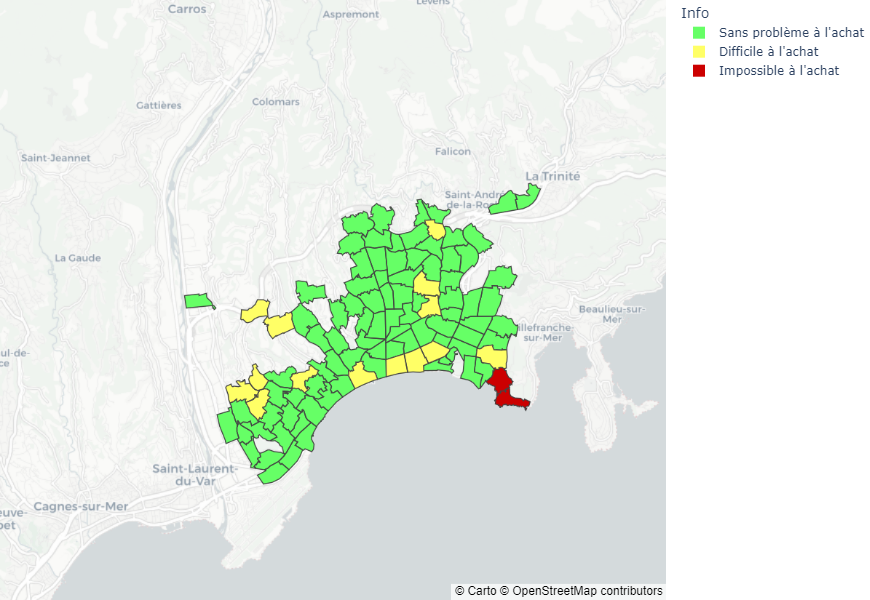

In [140]:
tracerfigsection(dvfcommune2019,geojsonSection,MontantPret2019)